# napari: Open images

There are multiple ways to open images in napari. We demonstrate here the most common ones.

## Adding images programmatically

Especially when designing an analysis pipeline (and not a plugin as we'll do later), it is very common to add images directly via one of the ```add_xxx``` commands. Upon re-executing the pipeline, this spares one from continuously manually selecting a file in the directory.

For this one simply needs to first import an image as a Numpy array:

In [1]:
import skimage
import napari
from napari.utils import nbscreenshot
import numpy as np

In [2]:
image = skimage.io.imread('https://github.com/guiwitz/PyImageCourse_beginner/raw/master/images/19838_1252_F8_1.tif')
image.shape

(2048, 2048, 3)

and then to add it to the viewer:

In [2]:
viewer = napari.Viewer()

In [4]:
viewer.add_image(image)

<Image layer 'image' at 0x17aab6af0>

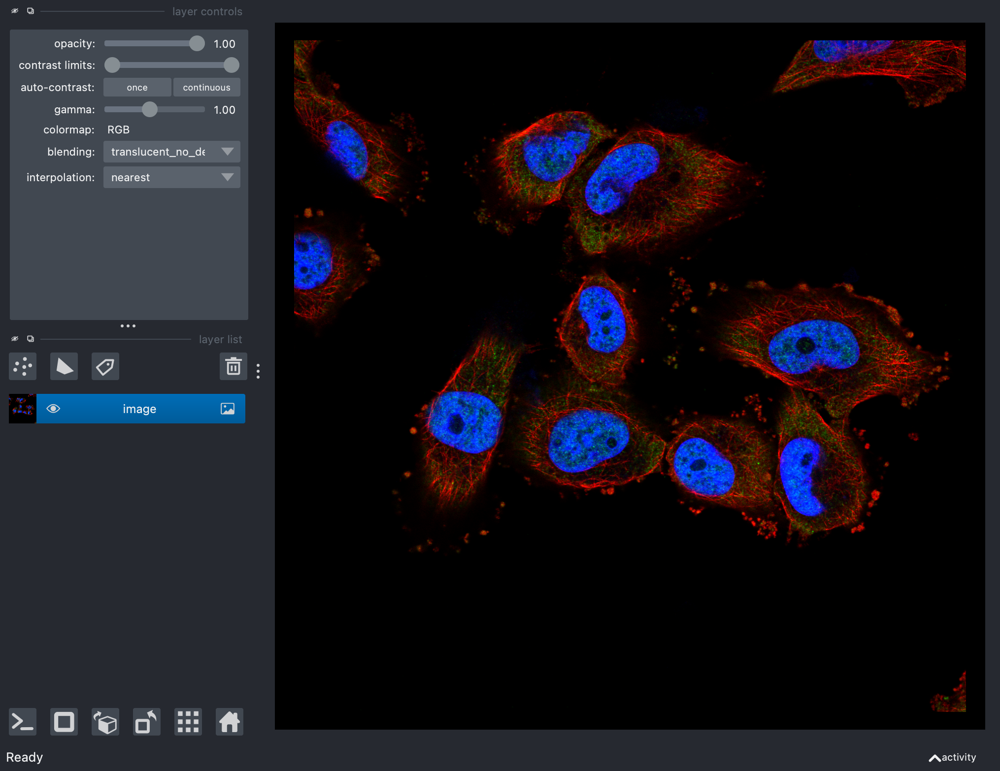

In [5]:
nbscreenshot(viewer, alt_text='Open numpy image')

As you can see above, napari has imported our image by default as an RGB image, and not as a true multi-channel image. To fix this we can tell napari that one of the dimensions should be used to represent channels:

In [6]:
viewer = napari.Viewer()
viewer.add_image(image, channel_axis=2)

[<Image layer 'Image' at 0x17e7d3cd0>,
 <Image layer 'Image [1]' at 0x17f21b310>,
 <Image layer 'Image [2]' at 0x17f601f10>]

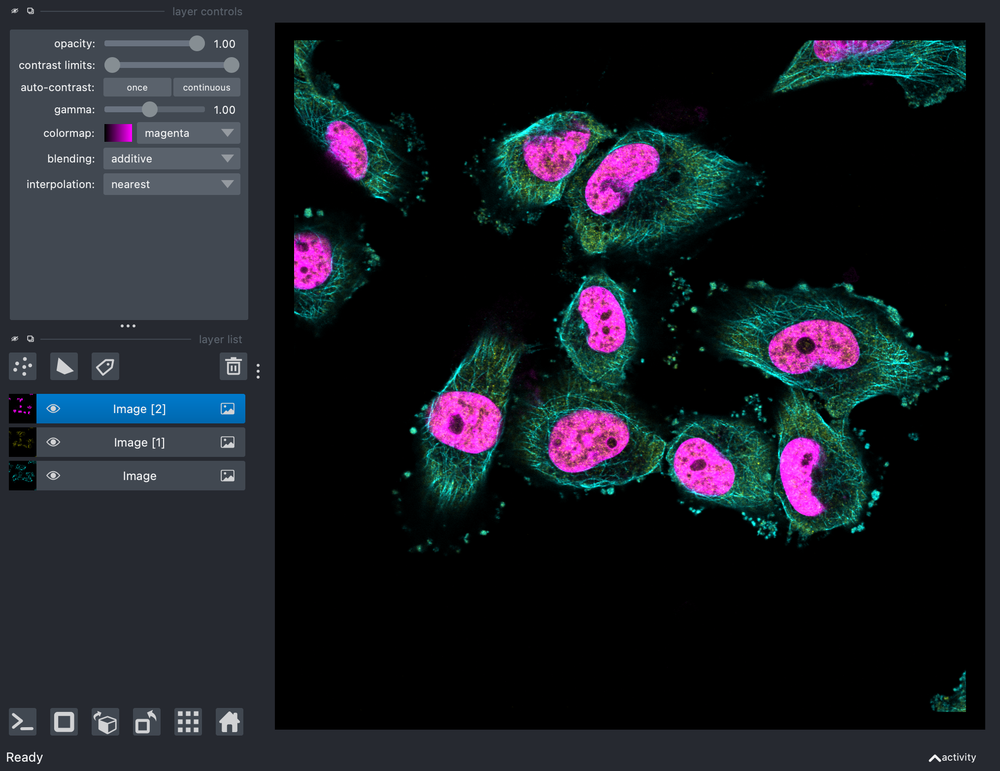

In [7]:
nbscreenshot(viewer, alt_text='Open numpy image with channels')

Now we have three layers, one for each channel, allowing us to perform usual image processing tasks.

## The ```open``` method

Instead of adding the image to the viewer, we can also use the ```open``` method:

In [8]:
viewer = napari.Viewer()
viewer.open('https://github.com/guiwitz/PyImageCourse_beginner/raw/master/images/19838_1252_F8_1.tif');

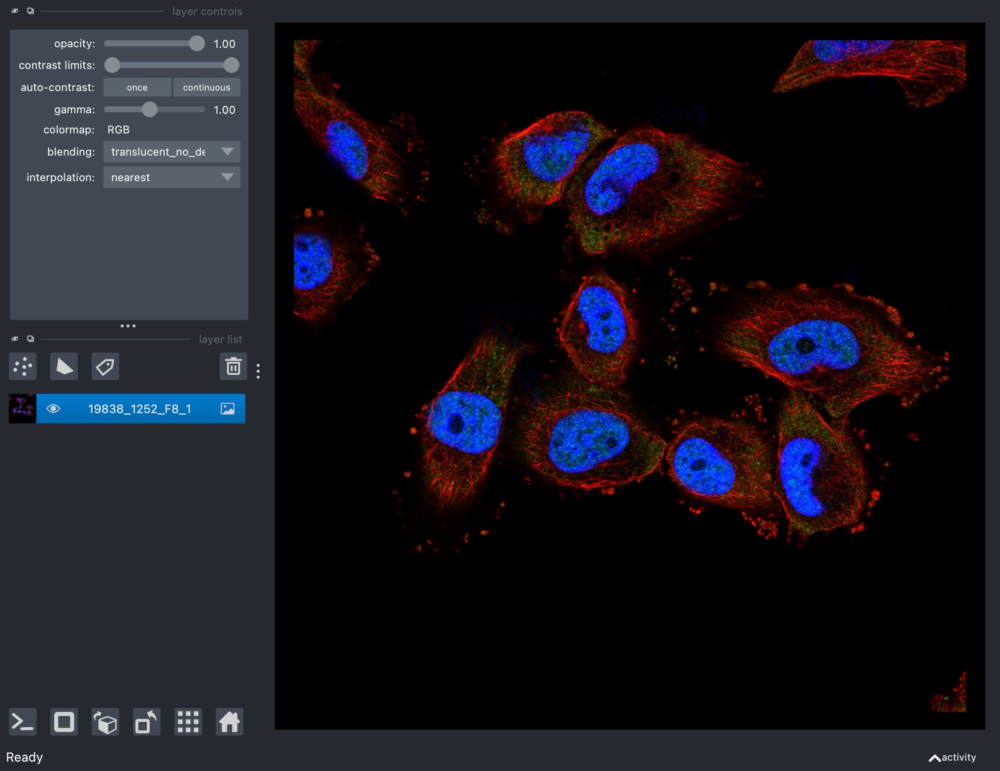

In [9]:
nbscreenshot(viewer, alt_text='Default opener')

napari here uses the default opener which in this case behaves similarly to adding images. We can also pass a series of paths, and all will be opened in the viewer:

In [10]:
viewer = napari.Viewer()
viewer.open(
    ['https://github.com/guiwitz/PyImageCourse_beginner/raw/master/images/19838_1252_F8_1.tif',
     'https://github.com/guiwitz/PyImageCourse_beginner/raw/master/images/24138_196_F7_2.tif']
);

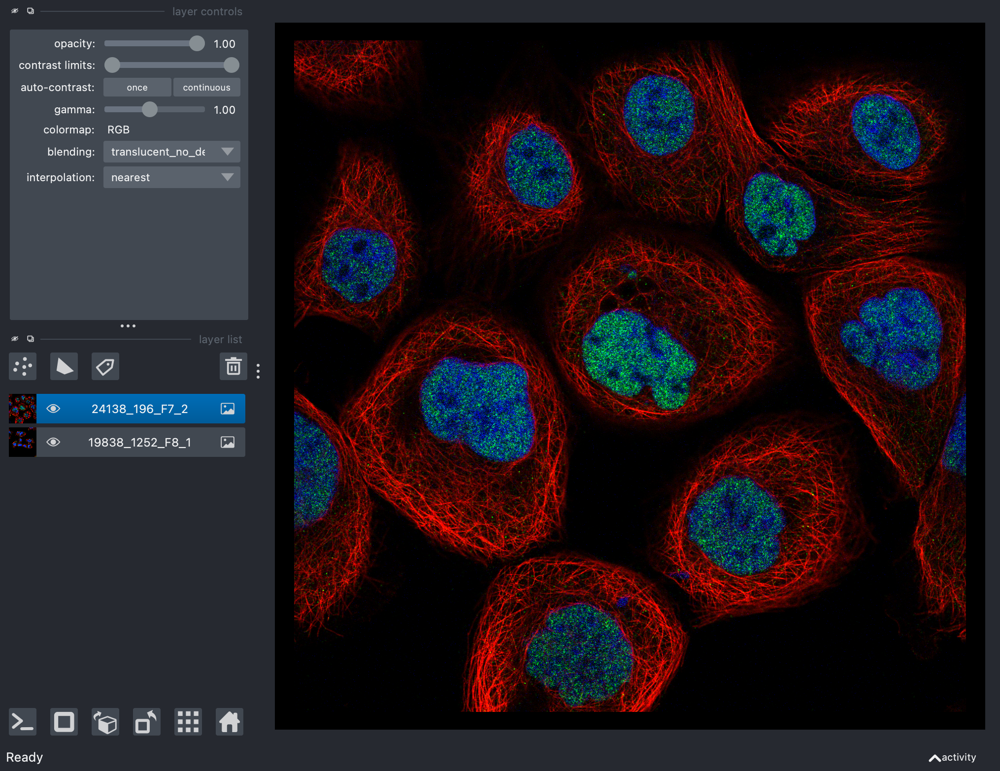

In [11]:
nbscreenshot(viewer, alt_text='Default opener')

## Using plugins

If you have reader plugins installed, you will be asked which one to use for opening when using the File -> Open menu. You can also specify the plugin to use when using the ```open``` method. Depending on the dimensions of your image and the available metadata, different plugins can give different results. Let's see an example for the idr9036378 dataset which contains a z-stack, time-lapse multi-channel image. 

For example if we use the [napari-aicsimageio](https://github.com/AllenCellModeling/napari-aicsimageio) plugin, we get:

In [6]:
viewer = napari.Viewer()
viewer.open(
    path='../data/idr9036378_cropped.tif',
    plugin='aicsimageio-in-memory'
);

Failed to parse XML for the provided file. Error: not well-formed (invalid token): line 1, column 6
Failed to parse XML for the provided file. Error: not well-formed (invalid token): line 1, column 6


AICSImageIO: Reader will load image in-memory: True


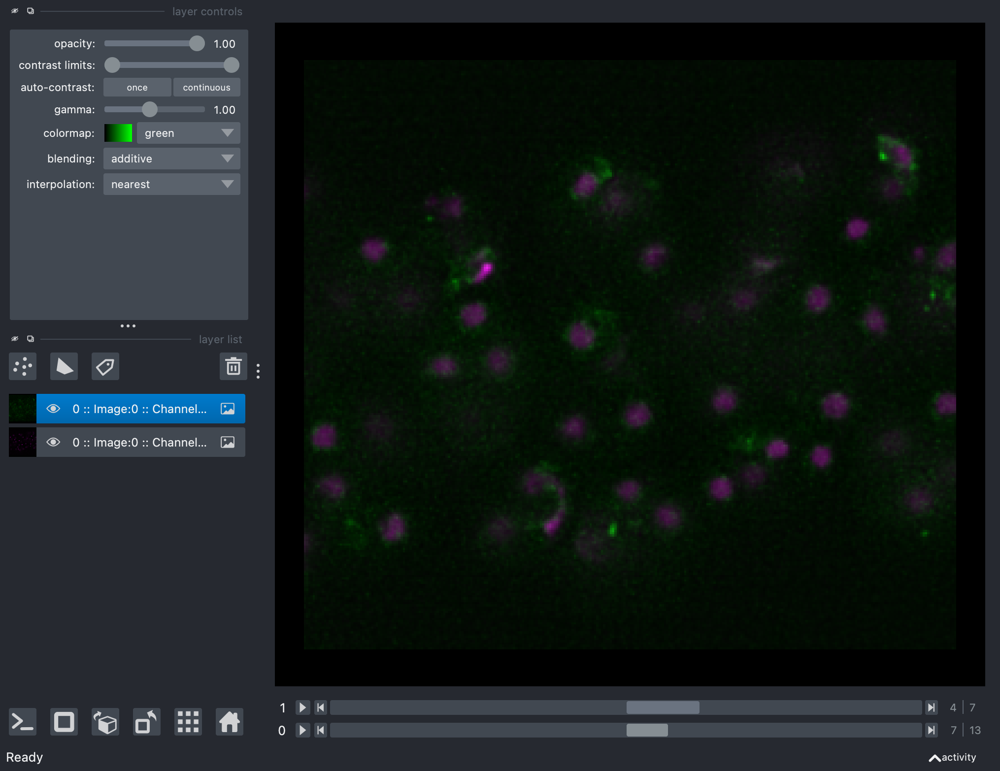

In [7]:
nbscreenshot(viewer, alt_text='aicsimageio opener')

We correctly get two layers, one for each channel, and then two sliders, one for z-stacks and one for time-lapse.

Now if we use the simple default reader:

In [8]:
viewer = napari.Viewer()
viewer.open(
    path='../data/idr9036378_cropped.tif',
    plugin='builtins'
);

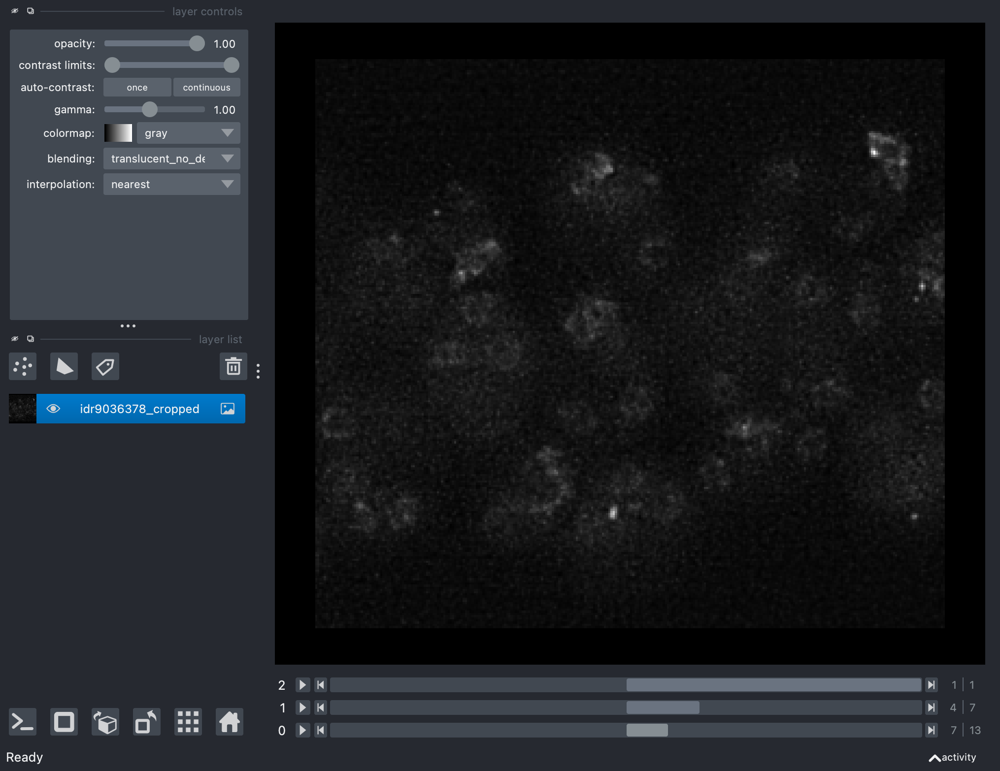

In [9]:
nbscreenshot(viewer, alt_text='Default opener')

The channels are not recognized as such and are simply turned into an additional nD slider.